# Data Mining Project

- ## Vladi VALSECCHI 730030
- ## Gianluca MOLTENI 730113
- ## Marco IMPERIALE 734486

### Imports

In [1]:
#import NLTK
import nltk
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
nltk.download('vader_lexicon')
nltk.download('stopwords')
from nltk.corpus import wordnet 
import string
from nltk import pos_tag
from nltk.corpus import stopwords
from nltk.tokenize import WhitespaceTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.sentiment.vader import SentimentIntensityAnalyzer

#import SKLEARN
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression, LogisticRegression, SGDClassifier
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.metrics import mean_squared_error, r2_score, roc_curve, roc_auc_score, auc, classification_report, confusion_matrix
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier

#import GENSIM+SMART OPEN
import smart_open
import gensim
from smart_open import open
from gensim.test.utils import common_texts
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

#import MLXTEND
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori

#import GEOPY
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="roba")

#import IPYTHON
from IPython.display import Image
from IPython.core.display import HTML

#import REVERSE GEOCODER
import reverse_geocoder as rg

#import PANDAS
import pandas as pd

#import SEABORN
import seaborn as sns

#import NUMPY
import numpy as np

#import MATPLOTLIB
import matplotlib.pyplot as plt

#import PLOTLY
import plotly.graph_objs as go

#import WORDCLOUD
from wordcloud import WordCloud

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\vladi\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\vladi\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\vladi\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\vladi\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
D:\Programmi\ANALconda\envs\gerry_scotti\lib\site-packages\gensim\utils.py:1197: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")


### Functions

In [2]:
#return a csv file in dataframe format
def load_dataset():
    
    return pd.read_csv("Hotel_Reviews.csv", encoding="Utf-8")#load dataset

In [3]:
#print shape and columns of a dataframe
def df_structure(df):
    print("shape: ",df.shape)
    print("columns: ",df.columns)

In [4]:
#plot pairplot of a dataframe
def pairplot(df):
    sns.pairplot(df)#pairplot of the dataframe

In [5]:
#check null values of the dataframe
def check_null_df(df):
    print(df.isnull().sum())#see if there are any missing values

In [6]:
#get lat, lng missing values from address and fill the dataframe
def fill_lat_lng_values(df):
    df_dummy= df[pd.isnull(df).any(axis=1)]#create a dataframe with only the rows with missing values
    indexlist=[x for x in df_dummy.index]#create indexlist
    geodict={}#create empty dictionary
    for x in range(len(indexlist)):
        addr=df.loc[indexlist[x]]['Hotel_Address']#get address
        spl=addr.split()#split address
        final=spl[-2]+' '+spl[-1]#city state
        if final in geodict:#if final is in the dictionary
            lat=geodict[final][0]#get latitude from dictionary
            lng=geodict[final][1]#get longitude from dictionary
            df.at[indexlist[x],'lat']=lat#insert latitude in df at the correct row
            df.at[indexlist[x],'lng']=lng#insert longitude in df at the correct row
        else:
            location = geolocator.geocode(final, language="en")#get location
            geodict[final]=[location.latitude,location.longitude]#get latitude and longitude
            df.at[indexlist[x],'lat']=location.latitude#insert latitude in df at the correct row
            df.at[indexlist[x],'lng']=location.longitude#insert longitude in df at the correct row
            
    return df

In [7]:
#convert dates in datetime format
def dates_to_datetime(df):
    df['Review_Date']=pd.to_datetime(df['Review_Date'])#set review date in datetime format
    
    return df

In [8]:
#remodel days since review column from string to int
def days_to_int(df):
    dsr=df.days_since_review
    days=[]
    for x in range(len(dsr)):
        str=dsr[x]
        days.append(int(str.split()[0]))
    df['days_since_review']=days
    
    return df

In [9]:
#create city and state columns
def add_city_country(df):
    df['Hotel_City']=""
    df['Hotel_Country']=""
    cord=tuple(zip(df['lat'],df['lng']))#get coordinates tuple
    res_rg=rg.search(cord)#resolving coordinates
    res_cc=[x.get('cc') for x in res_rg]#get country codes
    res_name=[x.get('name') for x in res_rg]#get city names
    #fill columns
    df['Hotel_City']=res_name
    df['Hotel_Country']=res_cc
    print("Added city and country values")
    
    return df

In [10]:
#print max and min score for each hotel
def get_max_min_score_hotels(df):
    
    return df.groupby(["Hotel_Name"]).Reviewer_Score.agg([max,min])

In [11]:
#get how many review the hotel got from each different reviewer nationality
def get_different_nationality_reviews_hotel(df):
    
    return df.groupby(["Hotel_Name",'Reviewer_Nationality']).Reviewer_Score.count()

In [12]:
#get the max review score the hotel got from each different reviewer nationality
def get_max_nationality_review_score_hotel(df):
    
    return df.groupby(["Hotel_Name",'Reviewer_Nationality']).Reviewer_Score.max()

In [13]:
#days since review boxplot
def dsr_boxplot(df):
    days_since_rev=[ x for x in df.days_since_review]#get days since review list
    tit="Distribution of the days since review"   
    fig = go.Figure()
    fig.add_trace(go.Box(y=days_since_rev, name=""))
    fig.update_layout(title=tit ,yaxis_title="Days Since Review",xaxis_title="Distribution")
    fig.show()

In [14]:
#get unique hotel nations
def get_unique_hotel_nations(df):
    nations=df.Hotel_Country.unique()
    
    return nations

In [15]:
#group by hotel country
def groupby_hotel_country(df):
    
    return df.groupby('Hotel_Country')

In [16]:
#Plot reviews per state
def reviews_per_state_plot(df):
    nations=get_unique_hotel_nations(df)
    Hotel_Country_GROUP=groupby_hotel_country(df)
    review_by_nations=[]#create list
    for x in range(len(nations)):
        review_by_nations.append(int(Hotel_Country_GROUP.get_group(nations[x]).shape[0]))#fill the list with the number of reviews per state
    for x in range(len(nations)):
        print(nations[x],": ",review_by_nations[x])#print nation name and reviews value
    #Plot
    plt.xticks(rotation='vertical')
    x_pos = np.arange(len(nations))
    plt.bar(x_pos, review_by_nations, align='center', color=['red', 'blue', 'green', 'orange','purple','lime'],edgecolor='black')
    plt.xticks(x_pos, nations)
    plt.grid(color='#95a5a6', linestyle='--', linewidth=2, axis='y', alpha=0.7)
    plt.ylabel('Number of reviews')
    plt.xlabel('State')
    plt.title('Reviews per state')
    for index,data in enumerate( review_by_nations):
        plt.text(x=index , y =data , s=f"{data}"[:8] , fontdict=dict(fontsize=11,horizontalalignment='center',
        verticalalignment='bottom'))
    plt.show()

In [17]:
#dataframe correlation matrix
def correlation_matrix(df,tit):
    corr = df[df.columns].corr()
    f, ax = plt.subplots(figsize=(15, 10))
    ax.set_title(f'{tit}'+' Correlation Matrix')
    ax=sns.heatmap(corr, cmap="YlGnBu", annot = True) 

In [18]:
#Plot hotel per state
def hotel_per_state_plot(df):
    nations=get_unique_hotel_nations(df)
    hotel_by_nations=[]#create list
    for x in range(len(nations)):
        hotel_by_nations.append(int(df[(df['Hotel_Country']==nations[x])].Hotel_Name.unique().shape[0]))#get hotel per state
    print("Count:")
    for x in range(len(nations)):
        print(nations[x],": ",hotel_by_nations[x])#print nation and hotel value
    #Plot
    plt.xticks(rotation='vertical')
    x_pos = np.arange(len(nations))
    plt.bar(x_pos, hotel_by_nations, align='center',  color=['red', 'blue', 'green', 'orange','purple','lime'],edgecolor='black')
    plt.grid(color='#95a5a6', linestyle='--', linewidth=2, axis='y', alpha=0.7)
    plt.xticks(x_pos, nations)
    plt.ylabel('Number of hotel')
    plt.xlabel('State')
    plt.title('Hotel per state')
    for index,data in enumerate(hotel_by_nations):
        plt.text(x=index , y =data , s=f"{data}"[:8] , fontdict=dict(fontsize=11,horizontalalignment='center',
        verticalalignment='bottom'))
    plt.show()

In [19]:
#get unique reviewer nationality list
def get_unique_reviewer_nationality(df):
    nationality=df.Reviewer_Nationality.unique().tolist()

    return nationality

In [20]:
#group by reviewer nationality
def group_rev_nat(df):
    
    return df.groupby('Reviewer_Nationality')

In [21]:
#Plot numer of reviews per nationality
def reviews_per_nationality(df):
    nationality=get_unique_reviewer_nationality(df)
    Reviewer_Nationality_GROUP=group_rev_nat(df)#group by reviewer nationality
    reviewers_by_nation=[]#create list
    for x in range(len(nationality)):
        reviewers_by_nation.append(int(Reviewer_Nationality_GROUP.get_group(nationality[x]).shape[0]))#get reviews per nationality
    union=[]#create list
    for x in range(len(reviewers_by_nation)):#merge reviews number and nationality
        dummylist=[]
        dummylist.append(reviewers_by_nation[x])
        dummylist.append(nationality[x])
        union.append(dummylist)
    union.sort()#sort list by reviews numebr
    nat=[]#create list
    rev=[]#create list
    for x in range(10):#extract first 10 nationality and score
        pos=x+1
        nat.append(union[-pos][1])
        rev.append(union[-pos][0])
        print(nat[x],": ",rev[x])
    #Plot
    plt.xticks(rotation='vertical')
    x_pos = np.arange(len(nat))
    plt.bar(x_pos, rev, align='center',edgecolor="black")
    plt.xticks(x_pos, nat)
    plt.grid(color='#95a5a6', linestyle='--', linewidth=2, axis='y', alpha=0.7)
    plt.ylabel('Reviewers')
    plt.xlabel('State')
    plt.title('Number of reviewers per state')
    for index,data in enumerate(rev):
        plt.text(x=index , y =data , s=f"{data}"[:8] , fontdict=dict(fontsize=11,horizontalalignment='center',
        verticalalignment='bottom'))
    plt.show()

In [22]:
#print hotel with min and max average score in general
def hotel_with_min_max_avg_score(df):
    avgscore=df.Average_Score.unique()#get unique average scores
    avgscore.sort()#sort scores
    avg_score_GROUP=df.groupby('Average_Score')#group by average score
    dfdummy_max_avg=avg_score_GROUP.get_group(avgscore[-1])#get max avg score group
    dfdummy_min_avg=avg_score_GROUP.get_group(avgscore[0])#get min avg score group
    max_name=dfdummy_max_avg.iloc[:1].Hotel_Name.values#get hotel name
    max_city=dfdummy_max_avg.iloc[:1].Hotel_City.values#get hotel city
    min_name=dfdummy_min_avg.iloc[:1].Hotel_Name.values#get hotel name
    min_city=dfdummy_min_avg.iloc[:1].Hotel_City.values#get hotel city
    print("Hotel with the highest Average_Score: ",max_name[0]," located in ",max_city[0]," with a score of ",avgscore[-1]," out of 10")
    print("Hotel with the lowest Average_Score: ",min_name[0]," located in ",min_city[0]," with a score of ",avgscore[0]," out of 10")

In [23]:
#boxplot average score distribution
def avg_score_boxplot(df):
    tit="Score Distribution"   
    fig = go.Figure()
    fig.add_trace(go.Box(y=df['Average_Score'], name=" "))
    fig.update_layout(title=tit ,yaxis_title="Score",xaxis_title="Distribution")
    fig.show()

In [24]:
#print positive reviews and negative reviews lengths
def review_pos_neg_lengths(df):
    print("Length of the longest negative review: ",df.Review_Total_Negative_Word_Counts.max()," words")
    print("Length of the shortest negative review: ",df.Review_Total_Negative_Word_Counts.min()," words")
    print("Length of the average negative review: ",df.Review_Total_Negative_Word_Counts.mean()," words")
    print()
    print("Length of the longest positive review: ",df.Review_Total_Positive_Word_Counts.max()," words")
    print("Length of the shortest positive review: ",df.Review_Total_Positive_Word_Counts.min()," words")
    print("Length of the average positive review: ",df.Review_Total_Positive_Word_Counts.mean()," words")

In [25]:
#print hotel with min and max average score for each nation
def hotels_min_max_avg_score(df):
    nations=get_unique_hotel_nations(df)
    Hotel_Country_GROUP=groupby_hotel_country(df)
    for x in range(len(nations)):
        dfdummy=Hotel_Country_GROUP.get_group(nations[x])#get group of nation x
        dummy_group=dfdummy.groupby('Average_Score')#group by average score
        print(nations[x])#print nation
        #get max
        dfdummy2=dummy_group.get_group(dfdummy.Average_Score.max())
        print(dfdummy2.iloc[:1].Hotel_Name.values[0],"located in ",dfdummy2.iloc[:1].Hotel_City.values[0],
              " with average score of: ",dfdummy.Average_Score.max())
        #get min
        dfdummy2=dummy_group.get_group(dfdummy.Average_Score.min())
        print(dfdummy2.iloc[:1].Hotel_Name.values[0],"located in ",dfdummy2.iloc[:1].Hotel_City.values[0],
              " with average score of: ",dfdummy.Average_Score.min())
        print()  

In [26]:
#create sentiment dataframe
def prepare_sentiment_df(df):
    df_sen=df.copy()
    df_sen["review"] = df["Negative_Review"] + df["Positive_Review"]#concat negative review and positive review
    df_sen["is_bad"] = df["Reviewer_Score"].apply(lambda x: 1 if x < 5 else 0)#add label to see if a review is negative or not
    df_sen = df_sen[["review", "is_bad","days_since_review","Reviewer_Nationality"]]#keep only selected columns
    df_bad = df_sen[df_sen["is_bad"] == 1]#get only bad reviews
    df_good = df_sen[df_sen["is_bad"] == 0]#get only good reviews
    df_sen = df_good.sample(frac = 0.05, replace = False, random_state=42)#sampling
    df_sen = pd.concat([df_sen, df_bad])#concat all
    df_sen["review"] = df_sen["review"].apply(lambda x: x.replace("No Negative", "").replace("No Positive", ""))#remove no negative and no positive
    print("Cleaning reviews")
    df_sen["review_clean"] = df_sen["review"].apply(lambda x: clean_text(x))
    print("Cleaning complete")
    
    return (df_sen)

In [27]:
def get_wordnet_pos(pos_tag):
    if pos_tag.startswith('J'):
        return wordnet.ADJ
    elif pos_tag.startswith('V'):
        return wordnet.VERB
    elif pos_tag.startswith('N'):
        return wordnet.NOUN
    elif pos_tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN

In [28]:
#prepare text
def clean_text(text):
    # lower text
    text = text.lower()
    # tokenize text and remove puncutation
    text = [word.strip(string.punctuation) for word in text.split(" ")]
    # remove words that contain numbers
    text = [word for word in text if not any(c.isdigit() for c in word)]
    # remove stop words
    stop = stopwords.words('english')
    text = [x for x in text if x not in stop]
    # remove empty tokens
    text = [t for t in text if len(t) > 0]
    # pos tag text
    pos_tags = pos_tag(text)
    # lemmatize text
    text = [WordNetLemmatizer().lemmatize(t[0], get_wordnet_pos(t[1])) for t in pos_tags]
    # remove words with only one letter
    text = [t for t in text if len(t) > 1]
    # join all
    text = " ".join(text)
    
    return(text)

In [29]:
#add sentiment analysis columns
def sentiment_analysis(df):
    print("Adding sentiment columns")
    sid = SentimentIntensityAnalyzer()
    df["sentiments"] = df["review"].apply(lambda x: sid.polarity_scores(x))
    df = pd.concat([df.drop(['sentiments'], axis=1), df['sentiments'].apply(pd.Series)], axis=1)
    print("Added sentiment columns")
    
    return (df)

In [30]:
#add number of words and number of chars for each review
def num_chars_words(df):
    print("Adding number of chars and words")
    df["nb_chars"] = df["review"].apply(lambda x: len(x))
    df["nb_words"] = df["review"].apply(lambda x: len(x.split(" ")))
    print("Added numbers")
    
    return(df)

In [31]:
#print distribution of a column
def show_distribution(df,col):
    print(df[col].value_counts(normalize = True))

In [32]:
#plot wordcloud
def wordcloud_plot(df):
    words = ''
    for review in df["review_clean"]:
        tokens = review.split()
        tokens = [i.lower() for i in tokens]
        words += ' '.join(tokens) + ' '
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white',
                    min_font_size = 10).generate(words) 
    plt.figure(figsize = (8, 8), facecolor = None) 
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.show()

In [33]:
#print reviews with most sentiment for a given parameter
def show_most_sentiment(df,sen):
    
    return (df[df["nb_words"] >= 5].sort_values(sen, ascending = False)[["review", sen]].head(10))

In [34]:
# plot sentiment distribution for positive and negative reviews
def sentiment_distribution_plot(df):
    for x in [0, 1]:
        subset = df[df['is_bad'] == x]
        # Draw the density plot
        if x == 0:
            label = "Good reviews"
        else:
            label = "Bad reviews"
        sns.distplot(subset['compound'], hist = False, label = label)

In [35]:
#stackplot of the pos,neu,neg columns of each review
def sentiment_stack_plot(df):
    neg=df.neg
    neu=df.neu
    pos=df.pos
    x= range(df.shape[0])
    labels=['Neg','Neu','Pos']
    plt.stackplot(x, neg, neu, pos)
    plt.xlabel('Review #')
    plt.legend(labels,loc='center right')
    plt.ylabel('Degree of membership')
    plt.title("Degree of membership for every review")
    plt.figure(figsize=(50,50))
    plt.show()   

In [36]:
#create correlation dataframe
def prepare_correlation_df(df):
    df_corr=df.copy()#copy df_rev
    df_corr=df[["days_since_review","Reviewer_Nationality","pos","neg"]]#keep only selected columns
    
    return (df_corr)

In [37]:
#print correlation between days since review and a given sentiment column in 3 different ways
def sentiment_correlation(df,col,sen):
    r_days = df.days_since_review.corr(df[col])#R correlation between days since review and given sentiment
    rho_days = df.days_since_review.corr(df[col], method='spearman')#RHO correlation between days since review and given sentiment
    tau_days = df.days_since_review.corr(df[col], method='kendall')#TAU correlation between days since review and given sentiment
    print("Correlation between days since review and "+f'{sen}'+" degree")
    print("Pearson's r: ", r_days)
    print("Spearman's rho: ",rho_days)
    print("Kendall's tau: ",tau_days)
    data=[["Pearson",r_days], [ "Spearman",rho_days],["Kendall",tau_days]]
    
    return data

In [38]:
#plot correlation between days since review and negative sentiment
def correlation_res_plot(data,tit):
    if tit=="pos":
        ali='bottom'
    else:
        ali='top'
    colors=["red", "lime", "cyan"]
    df = pd.DataFrame(data, columns=['Method', 'Value'])
    plt.bar(df["Method"],df["Value"], align='center',color=colors, edgecolor='black',linewidth=0.5)
    plt.xticks(df["Method"])
    plt.ylabel("Value")
    plt.xlabel("Methods")
    plt.title("Days since review and "+f"{tit}")
    for index,data in enumerate(df["Value"]):
        plt.text(x=index , y =data , s=f"{data}"[:8] , fontdict=dict(fontsize=11,horizontalalignment='center',
        verticalalignment=ali))

In [39]:
#print correlation between days since review and reviewer score in 3 ways
def correlation_dsr_score(df):
    print("Correlation between days since review and reviewer score")
    print("Pearson's r days-score: ",df.days_since_review.corr(df.Reviewer_Score))#R correlation between days since review and reviewer score
    print("Spearman's rho days-score: ",df.days_since_review.corr(df.Reviewer_Score, method='spearman'))#RHO correlation between days since review and reviewer score
    print("Kendall's tau days-score: ",df.days_since_review.corr(df.Reviewer_Score, method='kendall'))#TAU correlation between days since review and reviewer score

In [40]:
#print correlation between days since review and positive and negative sentiment for each nation in 3 ways
def correlation_days__sent_score_top_nationality(df):
    group_nationality=group_rev_nat(df)#group by reviewer nationality
    unique_nationality=get_unique_reviewer_nationality(df)#get unique 
    dummylist=[]#create list
    for x in range(len(unique_nationality)):#extract number of reviews made by each nationality and nationality
        dummylist2=[]
        dummy_group=group_nationality.get_group(unique_nationality[x])
        dummylist2.append(dummy_group.shape[0])
        dummylist2.append(unique_nationality[x])
        dummylist.append(dummylist2)
    dummylist.sort(reverse=True)#sort list
    nationalitylist=[]#create list
    for x in range(5):#get top 5 nationality
        nationalitylist.append(dummylist[x][1])
    #create 2 dataframes for the correlations based on positive and negative sentiment
    df_naz_pos = pd.DataFrame(columns=["Nation","Pearson","Spearman","Kendall"])
    df_naz_neg = pd.DataFrame(columns=["Nation","Pearson","Spearman","Kendall"])
    #print correlation between days since review and sentiment for the top 5 reviewer nations
    print("**********")
    for x in range(len(nationalitylist)):
        dfnationality=group_nationality.get_group(nationalitylist[x])
        #pos-days
        r_pos=dfnationality.days_since_review.corr(dfnationality.pos)
        rho_pos=dfnationality.days_since_review.corr(dfnationality.pos, method='spearman')
        tau_pos=dfnationality.days_since_review.corr(dfnationality.pos, method='kendall')
        df_naz_pos.loc[x]=[nationalitylist[x],  r_pos, rho_pos, tau_pos]
        #neg-days
        r_neg=dfnationality.days_since_review.corr(dfnationality.neg)
        rho_neg=dfnationality.days_since_review.corr(dfnationality.neg, method='spearman')
        tau_neg=dfnationality.days_since_review.corr(dfnationality.neg, method='kendall')
        df_naz_neg.loc[x]=[nationalitylist[x], r_neg, rho_neg, tau_neg]
        #out
        print("Correlation between days since review and sentiment degree of reviews made by reviewer from",nationalitylist[x])
        print()
        print("Pearson's r days-positivity: ",r_pos)
        print("Pearson's r days-negativity: ",r_neg)
        print()
        print("Spearman's rho days-positivity: ",rho_pos)
        print("Spearman's rho days-negativity: ",rho_neg)
        print()
        print("Kendall's tau days-positivity: ",tau_pos)
        print("Kendall's tau days-negativity: ",tau_neg)
        print()
        print("**********")
    #set index for the two dataframes
    df_naz_pos=df_naz_pos.set_index("Nation") 
    df_naz_neg=df_naz_neg.set_index("Nation")
        
    return (df_naz_pos,df_naz_neg)
    

In [41]:
#plot correlation between days since review and negative sentiment for each nation
def nationality_corr_plot(df,tit,cma):
    df.plot(kind='bar',
                    title= tit,
                    cmap=cma,
                    figsize=(10,6),
                    rot=30,
                    grid=True,
                    ylabel="Correlation value",
                    edgecolor="black");

In [42]:
#create frequent itemsets dataframe
def prepare_frequent_df(df):
    df_fre=df.copy()#copy dataframe
    df_fre = df_fre[["Positive_Review","Negative_Review","Tags"]]#keep only selected columns
    df_fre = df_fre.sample(frac = 0.05, replace = False, random_state=42)#sampling
    print("Cleaning positive reviews")
    df_fre["positive_clean"] = df_fre["Positive_Review"].apply(lambda x: clean_text(x))
    print("Cleaning positive complete")
    print("Cleaning negative reviews")
    df_fre["negative_clean"] = df_fre["Negative_Review"].apply(lambda x: clean_text(x))
    print("Cleaning negative complete")
    print("Cleaning tags")
    df_fre["tags_clean"] = df_fre["Tags"].apply(lambda x: clean_text(x))
    print("Cleaning tags complete") 
    print("Splitting values")
    df_fre['positive_split']=df_fre['positive_clean'].apply(lambda x: x.split(" "))
    df_fre['negative_split']=df_fre['negative_clean'].apply(lambda x: x.split(" "))
    df_fre['tags_split']=df_fre['tags_clean'].apply(lambda x: x.split(" "))
    print("Splitting done")
    
    return(df_fre)

In [43]:
#get list of columns for the given dataframe
def get_column_listed(df,col):
    
    return df[col].tolist()

In [44]:
#return frequent itemsets
def frequent_itemsets(split,sup):
    te = TransactionEncoder()
    te_ary = te.fit(split).transform(split)
    df_split = pd.DataFrame(te_ary, columns=te.columns_)
    freq = apriori(df_split, min_support=sup, use_colnames=True)
    freq['length'] = freq['itemsets'].apply(lambda x: len(x))
    
    return freq

In [45]:
#print frequent itemsets
def out_freq(freq):
    print(freq[ (freq['length'] > 1)].sort_values(by='support', ascending=False))

In [46]:
#create regression dataframe
def prepare_regression_df(df):
    df_reg=df.copy()#dataframe copy
    df_reg = df_reg[["Review_Date","Reviewer_Score","Hotel_Country"]]#keep only selected columns
    df_reg.set_index("Review_Date", inplace = True)#set review date as indec
    df_reg["is_bad"] = df_reg["Reviewer_Score"].apply(lambda x: 1 if x < 5 else 0)#add label to see if a review is negative or not
    
    return(df_reg)

In [47]:
#return a group by state only for positive reviews
def get_reg_group(df):
    is_bad_group=df.groupby("is_bad")#grouping by is_bad
    positive_group=is_bad_group.get_group(0)#extracting only positive reviews
    state_group=positive_group.groupby("Hotel_Country")#grouping by state
    
    return (state_group)

In [48]:
#plot regression
def plot_reg(X,y,y_p,nat):
    print(nat)
    plt.scatter(X, y, color = 'blue')
    plt.plot(X, y_p, color = 'red')
    plt.title('score vs day of the year')
    plt.xlabel('day of the year')
    plt.ylabel('score')
    plt.show()

In [49]:
#regression for each state between days of the year and score of the day
def regression_per_state(df):
    nations=get_unique_hotel_nations(df)
    state_group=get_reg_group(df)
    for x in range(len(nations)):
        nat=nations[x]
        group=state_group.get_group(nat)#get nation group
        group_mean = group.groupby([group.index.month, group.index.day]).mean()#compute mean
        group_mean['pos']=np.arange(group_mean.shape[0])+1#add utility column to have the position in the year aka 1 = 1st gennaio
        X=group_mean[["pos"]]#get x values
        y=group_mean[["Reviewer_Score"]]  #get y values  
        poly_model = make_pipeline(PolynomialFeatures(7),LinearRegression())#make pipeline
        poly_model.fit(X, y)#fit model
        y_pred = poly_model.predict(X)#predict
        plot_reg(X,y,y_pred,nat)#plot results
        print("R2 score : %.2f" % r2_score(y,y_pred))#print R2 score
        print("Mean squared error: %.2f" % mean_squared_error(y,y_pred))#print MSE
        print()

In [50]:
#create mlp classifier dataframe
def prepare_mlp_df(df):
    df_pred_MLP=df.copy()#copy dataframe
    df_pred_MLP = df[["review","review_clean","is_bad","nb_chars","nb_words","neg","neu","pos","compound"]]#keep only selected columns
    print("Adding doc2vec columns")
    # create doc2vec vector columns
    documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(df_pred_MLP["review_clean"].apply(lambda x: x.split(" ")))]
    # train a Doc2Vec model
    model = Doc2Vec(documents, vector_size=5, window=2, min_count=1, workers=4)
    # transform each document into a vector data
    doc2vec_df = df_pred_MLP["review_clean"].apply(lambda x: model.infer_vector(x.split(" "))).apply(pd.Series)
    doc2vec_df.columns = ["doc2vec_vector_"+f'{x}' for x in doc2vec_df.columns]
    df_pred_MLP = pd.concat([df_pred_MLP, doc2vec_df], axis=1)
    print("Added doc2vec columns")
    print("Adding tf-idf columns")
    tfidf = TfidfVectorizer(min_df = 10)
    tfidf_result = tfidf.fit_transform(df_pred_MLP["review_clean"]).toarray()
    tfidf_df = pd.DataFrame(tfidf_result, columns = tfidf.get_feature_names())
    tfidf_df.columns = ["word_" + f'{x}' for x in tfidf_df.columns]
    tfidf_df.index = df_pred_MLP.index
    df_pred_MLP = pd.concat([df_pred_MLP, tfidf_df], axis=1)    
    print("Added tf-idf columns")
    newDataTF = TfidfVectorizer(analyzer='word', ngram_range=(1, 2), stop_words="english", lowercase=True, max_features=500000, vocabulary=tfidf.vocabulary_)
    
    return(df_pred_MLP,newDataTF,model)   

In [51]:
#feature selection for mlp classifier
def feature_selection_tts_mlp(df):
    # feature selection
    label = "is_bad"
    ignore_cols = [label, "review", "review_clean"]
    features = [c for c in df.columns if c not in ignore_cols]
    # split the data into train and test
    X_train_MLP, X_test_MLP, y_train_MLP, y_test_MLP = train_test_split(df[features], df[label], test_size = 0.20, random_state = 42)
    
    return X_train_MLP, X_test_MLP, y_train_MLP, y_test_MLP

In [52]:
#train mlp classifier model
def mlp_train(X_train_MLP, y_train_MLP):
    # train a neural network 1000000
    mlp = MLPClassifier(hidden_layer_sizes=(256, 32, 8),max_iter=1000000,early_stopping=True,verbose=True,tol=0.000005,n_iter_no_change=15, random_state=42)
    mlp.fit(X_train_MLP, y_train_MLP)
    
    return(mlp)

In [53]:
#test mlp classifier model
def mlp_test(mlp,X_test_MLP):
    predictions_MLP = mlp.predict(X_test_MLP)#make prediction with test set
    
    return predictions_MLP

In [54]:
#get false positive rate, true positive rate, tresholds and roc auc
def roc_conf_class_rep(y_test, predictions):
    print('AUC: ', roc_auc_score(y_test, predictions))#print AUC
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, predictions)#get fpr,tpr, tresholds
    roc_auc = auc(false_positive_rate, true_positive_rate)#get roc auc
    print(confusion_matrix(y_test,predictions))
    print(classification_report(y_test,predictions))

    return false_positive_rate, true_positive_rate, thresholds, roc_auc

In [55]:
#plot roc graph
def plot_ROC(fpr,tpr,roc_auc):
    plt.figure()
    lw = 2
    plt.plot(fpr, tpr, color='darkorange', label='ROC curve (area = %0.2f)' % roc_auc, lw=lw,)
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC curve plot')
    plt.legend(loc="lower right")
    plt.show()

In [56]:
#prepare input for mlp classifier
def PrepareInput(review,newDataTF,d2vm):
    model=d2vm
    sid = SentimentIntensityAnalyzer()
    review = clean_text(review)
    modelInput = pd.DataFrame(sid.polarity_scores(review), index=[0])
    modelInput['nb_chars'] = len(review)
    modelInput['nb_words'] = len(review.split(" "))
    d2vVectors = [model.infer_vector(review.split(" "))]
    d2vDF = pd.DataFrame(d2vVectors, index=[0], columns=["doc2vec_vector_" + f'{x}' for x in range(len(d2vVectors[0]))])
    modelInput = pd.concat([modelInput, d2vDF], axis=1)
    modelInputTfidfResult = newDataTF.fit_transform([review]).toarray()
    modelInputTfidfDf = pd.DataFrame(modelInputTfidfResult, columns=newDataTF.get_feature_names())
    modelInputTfidfDf.columns = ["word_" + f'{x}' for x in modelInputTfidfDf.columns]
    modelInputTfidfDf.index = [0]
    modelInput = pd.concat([modelInput, modelInputTfidfDf], axis=1)
    
    return modelInput

#mlp classifier predit review
def MLP_PredictReview(mlp, review,tfidf,d2vm):
    modelIn = PrepareInput(review,tfidf,d2vm)
    modelPrediction = mlp.predict(modelIn)
    if modelPrediction[0] == 0:
        print("Good review")
    else:
        print("Bad review")
        
    return modelPrediction

In [57]:
#create logistic regression model dataframe
def prepare_lr_df(df):
    df_pred_LR=df.copy()#copy dataframe
    df_pred_LR = df_pred_LR[["review", "is_bad"]]#keep only selected columns
    
    return(df_pred_LR)

In [58]:
#feature selection logistic regression model
def feature_selection_tts_lr(df):
    #train test split
    X_train_LR, X_test_LR, y_train_LR, y_test_LR = train_test_split(df['review'], df['is_bad'], test_size = 0.20,random_state=42)
    
    return X_train_LR, X_test_LR, y_train_LR, y_test_LR

In [59]:
#train selection logistic regression model
def lrm_train(X_train_LR, y_train_LR):
    vect = CountVectorizer(min_df=5, ngram_range=(1,2)).fit(X_train_LR)#create count vectorizer
    X_train_vectorized_LR = vect.transform(X_train_LR)#transform X train
    lrm = LogisticRegression(solver='liblinear')#define logistic regressor
    lrm.fit(X_train_vectorized_LR, y_train_LR)#fit model
    
    return lrm,vect

In [60]:
#test selection logistic regression model
def lrm_test(lrm,X_test_LR,vect):
    predictions_LR = lrm.predict(vect.transform(X_test_LR))#make prediction with test set
    
    return predictions_LR

In [61]:
#predict selection logistic regression model
def LRM_PredictReview(rev,vect):
    pred=lrm.predict(vect.transform([rev]))
    if pred[0] == 0:
        print("Good review")
    else:
        print("Bad review")
        
    return pred

---------------------------------
### Loading dataset
<a href="https://www.kaggle.com/jiashenliu/515k-hotel-reviews-data-in-europe?select=Hotel_Reviews.csv">dataset can be found here</a>

In [62]:
#the csv file must be in the same folder as the ipynb file
#and must be called Hotel_Reviews.csv
df=load_dataset()

In [63]:
df_structure(df)
df.head(3)

shape:  (515738, 17)
columns:  Index(['Hotel_Address', 'Additional_Number_of_Scoring', 'Review_Date',
       'Average_Score', 'Hotel_Name', 'Reviewer_Nationality',
       'Negative_Review', 'Review_Total_Negative_Word_Counts',
       'Total_Number_of_Reviews', 'Positive_Review',
       'Review_Total_Positive_Word_Counts',
       'Total_Number_of_Reviews_Reviewer_Has_Given', 'Reviewer_Score', 'Tags',
       'days_since_review', 'lat', 'lng'],
      dtype='object')


,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968


### Dataset description


* This dataset contains 515738 customer reviews and scoring of several luxury hotels across Europe.

The csv file contains 17 fields:
* Hotel_Address: Address of hotel;
* Review_Date: Date when reviewer posted the corresponding review;
* Average_Score: Average Score of the hotel;
* Hotel_Name: Name of Hotel;
* Reviewer_Nationality: Nationality of Reviewer;
* Negative_Review: Negative Review the reviewer gave to the hotel;
* ReviewTotalNegativeWordCounts: Total number of words in the negative review;
* Positive_Review: Positive Review the reviewer gave to the hotel;
* ReviewTotalPositiveWordCounts: Total number of words in the positive review;
* Reviewer_Score: Score the reviewer has given to the hotel;
* TotalNumberofReviewsReviewerHasGiven: Number of Reviews the reviewers has given in the past;
* TotalNumberof_Reviews: Total number of valid reviews the hotel has;
* Tags: Tags reviewer gave the hotel;
* dayssincereview: Duration between the review date and scrape date;
* AdditionalNumberof_Scoring: There are also some guests who just made a scoring on the service rather than a review;
* lat: Latitude of the hotel;
* lng: longtitude of the hotel.
--------------------------------

### Null value management

In [64]:
check_null_df(df)

Hotel_Address                                    0
Additional_Number_of_Scoring                     0
Review_Date                                      0
Average_Score                                    0
Hotel_Name                                       0
Reviewer_Nationality                             0
Negative_Review                                  0
Review_Total_Negative_Word_Counts                0
Total_Number_of_Reviews                          0
Positive_Review                                  0
Review_Total_Positive_Word_Counts                0
Total_Number_of_Reviews_Reviewer_Has_Given       0
Reviewer_Score                                   0
Tags                                             0
days_since_review                                0
lat                                           3268
lng                                           3268
dtype: int64


3268 rows with lat and lng values missing.

In [65]:
df=fill_lat_lng_values(df)

In [66]:
check_null_df(df)

Hotel_Address                                 0
Additional_Number_of_Scoring                  0
Review_Date                                   0
Average_Score                                 0
Hotel_Name                                    0
Reviewer_Nationality                          0
Negative_Review                               0
Review_Total_Negative_Word_Counts             0
Total_Number_of_Reviews                       0
Positive_Review                               0
Review_Total_Positive_Word_Counts             0
Total_Number_of_Reviews_Reviewer_Has_Given    0
Reviewer_Score                                0
Tags                                          0
days_since_review                             0
lat                                           0
lng                                           0
dtype: int64


Filled the missing lat and lng values by extracting them from the Hotel_Address

--------------------------------
### Data transformation

In [67]:
df=days_to_int(df)

In [68]:
df=dates_to_datetime(df)

Converted days from string to int and dates in datetime format

--------------------------------
### Get city and country from latitude and longitude

In [69]:
df=add_city_country(df)

Loading formatted geocoded file...
Added city and country values


In [70]:
df_structure(df)
df.head(3)

shape:  (515738, 19)
columns:  Index(['Hotel_Address', 'Additional_Number_of_Scoring', 'Review_Date',
       'Average_Score', 'Hotel_Name', 'Reviewer_Nationality',
       'Negative_Review', 'Review_Total_Negative_Word_Counts',
       'Total_Number_of_Reviews', 'Positive_Review',
       'Review_Total_Positive_Word_Counts',
       'Total_Number_of_Reviews_Reviewer_Has_Given', 'Reviewer_Score', 'Tags',
       'days_since_review', 'lat', 'lng', 'Hotel_City', 'Hotel_Country'],
      dtype='object')


,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng,Hotel_City,Hotel_Country
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,2017-08-03,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0,52.360576,4.915968,Amsterdam,NL
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,2017-08-03,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0,52.360576,4.915968,Amsterdam,NL
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,2017-07-31,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3,52.360576,4.915968,Amsterdam,NL


Added and filled Hotel_City and Hotel_Country columns by extracting values from lat and lng.

New columns:
* Hotel_City: city of the hotel;
* Hotel_Country: country code of the hotel.

--------------------------------
### Feature visualization

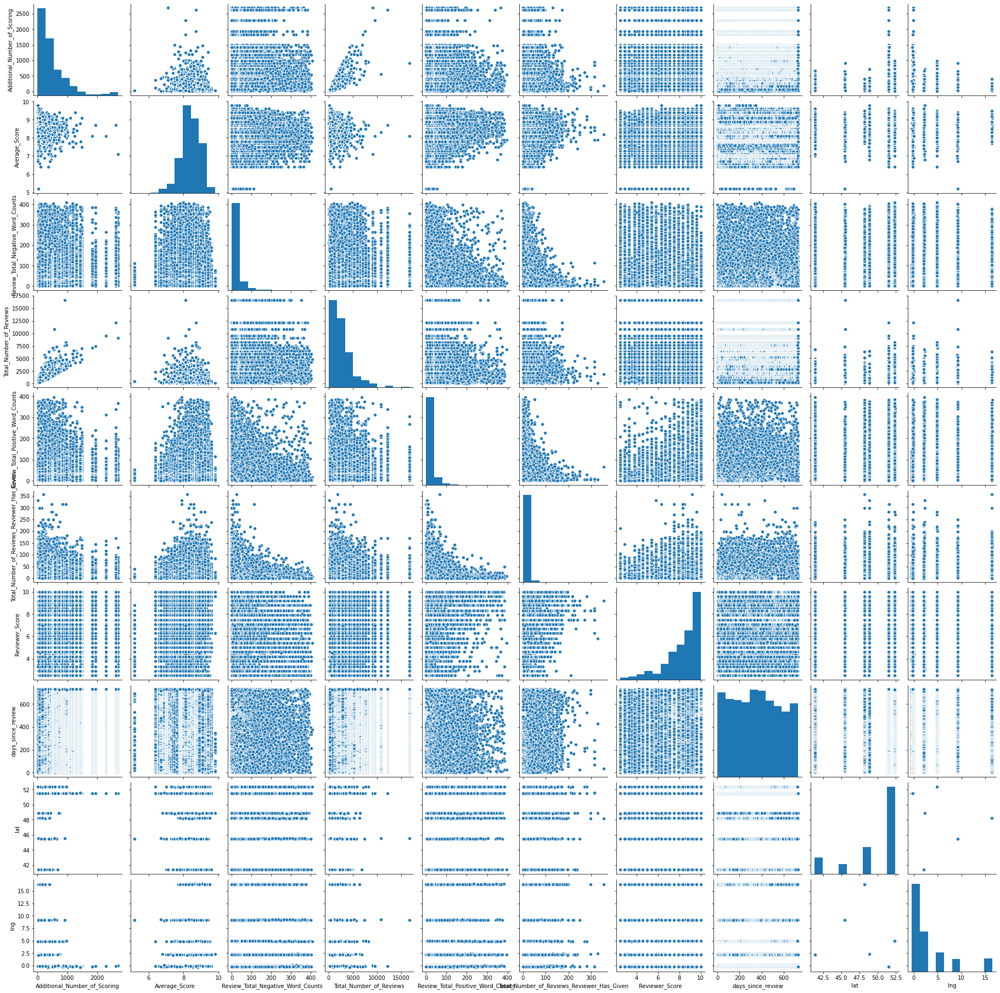

In [71]:
pairplot(df)

Plot pairwise relationships in Hotel Review dataframe.

The diagonal plots are a univariate distribution plot, made to show the marginal distribution of the data in each column.

In [72]:
df_dummy=get_max_min_score_hotels(df)
df_dummy

,max,min
Hotel_Name,,
11 Cadogan Gardens,10.0,4.2
1K Hotel,10.0,3.8
25hours Hotel beim MuseumsQuartier,10.0,2.5
41,10.0,6.7
45 Park Lane Dorchester Collection,10.0,8.3
...,...,...
citizenM London Bankside,10.0,2.9
citizenM London Shoreditch,10.0,2.5
citizenM Tower of London,10.0,3.0


For each hotel shows max score and min score

In [73]:
df_dummy=get_different_nationality_reviews_hotel(df)
df_dummy

Hotel_Name          Reviewer_Nationality      
11 Cadogan Gardens   Australia                     5
                     Austria                       1
                     Belgium                       2
                     Bermuda                       1
                     Brazil                        1
                                                  ..
pentahotel Vienna    Turkey                        1
                     Ukraine                       3
                     United Arab Emirates          4
                     United Kingdom               19
                     United States of America      3
Name: Reviewer_Score, Length: 65112, dtype: int64

For each hotel it shows how many reviewers from a particular country have made reviews

In [74]:
df_dummy=get_max_nationality_review_score_hotel(df)
df_dummy

Hotel_Name          Reviewer_Nationality      
11 Cadogan Gardens   Australia                    10.0
                     Austria                      10.0
                     Belgium                       9.2
                     Bermuda                       9.6
                     Brazil                        9.6
                                                  ... 
pentahotel Vienna    Turkey                        9.6
                     Ukraine                       8.3
                     United Arab Emirates          8.8
                     United Kingdom               10.0
                     United States of America     10.0
Name: Reviewer_Score, Length: 65112, dtype: float64

For each hotel it shows the highest rating given by reviewers from a particular country

In [75]:
dsr_boxplot(df)

The boxplot shows the days_since_review distribution.

* Min value: 0
* q1: 175
* median: 353
* q3: 527
* Max value:730

No outliers

In [76]:
nations=get_unique_hotel_nations(df)
print("Hotel nations: ",nations)

Hotel nations:  ['NL' 'GB' 'FR' 'ES' 'IT' 'AT']


Nations:
* NL: Netherlands;
* GB: United Kingdom;
* FR: France;
* ES: Spain;
* IT: Italy;
* AT: Austria.

NL :  57214
GB :  262301
FR :  59928
ES :  60149
IT :  37207
AT :  38939


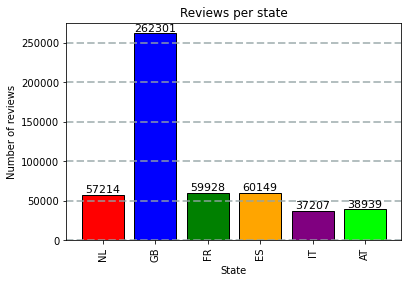

In [77]:
reviews_per_state_plot(df)

The graph shows that the vast majority of reviews made refer to hotels in the United Kingdom. The rest of the states have a similar value of reviews, around 60.000, except for Italy and Austria which is around 40.000.

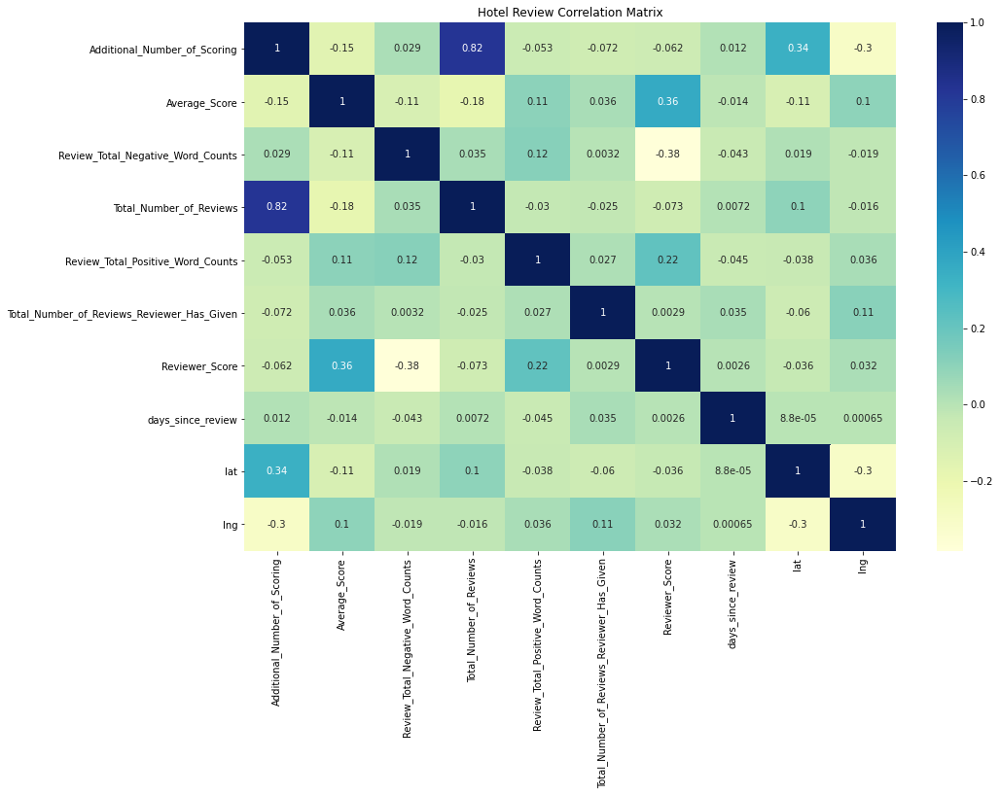

In [78]:
correlation_matrix(df,"Hotel Review")

The correlation matrix shows that Total_Number_of_reviews and Additional_Number_of_Scoring are highly correlated with each other with a high positive correlation value showing that the higher the number of reviews the higher the additional values.

Reviewer_Score and Review_Total_Negative_Word_Counts are highly correlated negatively showing that the higher the score the fewer negative words are in the review.

Count:
NL :  105
GB :  400
FR :  458
ES :  211
IT :  162
AT :  158


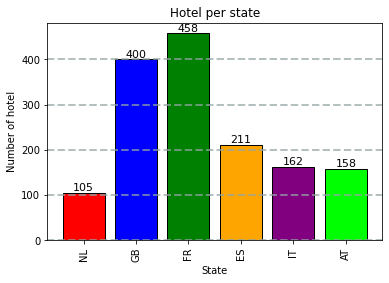

In [79]:
hotel_per_state_plot(df)

In this graph we have the comparison of the number of hotels by state. Most of the hotels in the dataset are located in France and the United Kingdom. There are fewest are in the Netherlands.

In [80]:
nationality=get_unique_reviewer_nationality(df)
print("Reviewer nationalities: ",nationality)

Reviewer nationalities:  [' Russia ', ' Ireland ', ' Australia ', ' United Kingdom ', ' New Zealand ', ' Poland ', ' Belgium ', ' Norway ', ' France ', ' Italy ', ' Canada ', ' Netherlands ', ' Germany ', ' United States of America ', ' Hungary ', ' Israel ', ' Switzerland ', ' India ', ' United Arab Emirates ', ' Malaysia ', ' Denmark ', ' South Africa ', ' Rwanda ', ' Finland ', ' Portugal ', ' Luxembourg ', ' Spain ', ' Malta ', ' China ', ' Turkey ', ' Ukraine ', ' Gibraltar ', ' Argentina ', ' Abkhazia Georgia ', ' Isle of Man ', ' Sweden ', ' Croatia ', ' Saudi Arabia ', ' Lithuania ', ' Slovenia ', ' Panama ', ' Austria ', ' Brazil ', ' Taiwan ', ' Iceland ', ' Iran ', ' Liechtenstein ', ' Chile ', ' Hong Kong ', ' United States Minor Outlying Islands ', ' Morocco ', ' Oman ', ' Lebanon ', ' Qatar ', ' Nigeria ', ' Romania ', ' Czech Republic ', ' Greece ', ' Thailand ', ' Singapore ', ' Guernsey ', ' Latvia ', ' Namibia ', ' Japan ', ' Egypt ', ' Slovakia ', ' South Korea ', ' 

List of different reviewer nationalities.

 United Kingdom  :  245246
 United States of America  :  35437
 Australia  :  21686
 Ireland  :  14827
 United Arab Emirates  :  10235
 Saudi Arabia  :  8951
 Netherlands  :  8772
 Switzerland  :  8678
 Germany  :  7941
 Canada  :  7894


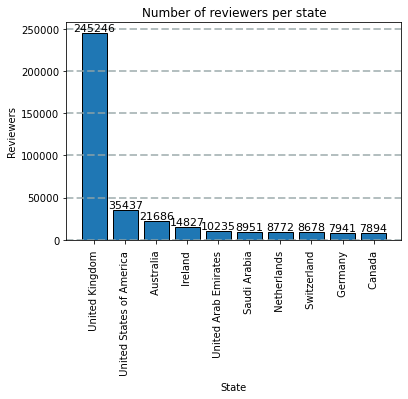

In [81]:
reviews_per_nationality(df)

From the comparison chart of the number of reviews made by reviewers of various nationalities, it is clear that the vast majority of reviews were made by UK residents.

In [82]:
hotel_with_min_max_avg_score(df)

Hotel with the highest Average_Score:  Ritz Paris  located in  Paris  with a score of  9.8  out of 10
Hotel with the lowest Average_Score:  Hotel Liberty  located in  Milano  with a score of  5.2  out of 10


In [83]:
avg_score_boxplot(df)

The boxplot shows the distribution of single reviews scores of the whole dataset.

Min : 5.2
Lower fence: 7.1
q1: 8.1
median: 8.4
q3: 8.8
Max 9.8

There are 7 outliers.

In [84]:
review_pos_neg_lengths(df)

Length of the longest negative review:  408  words
Length of the shortest negative review:  0  words
Length of the average negative review:  18.539450263505888  words

Length of the longest positive review:  395  words
Length of the shortest positive review:  0  words
Length of the average positive review:  17.77645820164502  words


In [85]:
hotels_min_max_avg_score(df)

NL
Waldorf Astoria Amsterdam located in  Amsterdam  with average score of:  9.5
Savoy Hotel Amsterdam located in  Amsterdam  with average score of:  6.4

GB
Haymarket Hotel located in  London  with average score of:  9.6
Hotel Cavendish located in  London  with average score of:  6.4

FR
Ritz Paris located in  Paris  with average score of:  9.8
Villa Eugenie located in  Clichy  with average score of:  6.8

ES
Hotel Casa Camper located in  Ciutat Vella  with average score of:  9.6
Gran Hotel Barcino located in  Ciutat Vella  with average score of:  7.0

IT
Excelsior Hotel Gallia Luxury Collection Hotel located in  Milano  with average score of:  9.4
Hotel Liberty located in  Milano  with average score of:  5.2

AT
Palais Coburg Residenz located in  Vienna  with average score of:  9.5
Exe Vienna located in  Vienna  with average score of:  7.7



---------------
### Sentiment analysis

In [86]:
df_sen=prepare_sentiment_df(df)
df_sen=sentiment_analysis(df_sen)
df_sen=num_chars_words(df_sen)

Cleaning reviews
Cleaning complete
Adding sentiment columns
Added sentiment columns
Adding number of chars and words
Added numbers


In [87]:
df_structure(df_sen)
df_sen.head(3)

shape:  (46954, 11)
columns:  Index(['review', 'is_bad', 'days_since_review', 'Reviewer_Nationality',
       'review_clean', 'neg', 'neu', 'pos', 'compound', 'nb_chars',
       'nb_words'],
      dtype='object')


,review,is_bad,days_since_review,Reviewer_Nationality,review_clean,neg,neu,pos,compound,nb_chars,nb_words
275107,Nothing Breakfast was excellent metro statio...,0,215,Saudi Arabia,nothing breakfast excellent metro station mete...,0.158,0.842,0.000,-0.4585,105,20
479647,Everything was lovely Would recommend it to e...,0,395,United Kingdom,everything lovely would recommend everyone wan...,0.000,0.495,0.505,0.8807,88,16
103961,For subsequent 3 days no wifi service even th...,0,253,Hong Kong,subsequent day wifi service even telephone una...,0.071,0.719,0.210,0.9296,486,90


New columns:
* review: merge of negative review and positive review;
* is_bad: 1 if score < 5, 0 if not;
* review_clean: review without stopwords, all in lower case;
* neg,neu,pos: sentiment score for negative sentiment, neutral sentiment, positive sentiment;
* compound: overall score that summarizes the previous scores;
* nb_chars: number of characters in the review;
* nb_words: number of words in the review.

-----------------
### Sentiment analysis - Exploratory data analysis

In [88]:
show_distribution(df_sen,"is_bad")

0    0.525472
1    0.474528
Name: is_bad, dtype: float64


In our sampling we have 52% of positive reviews and 48% of negative reviews.

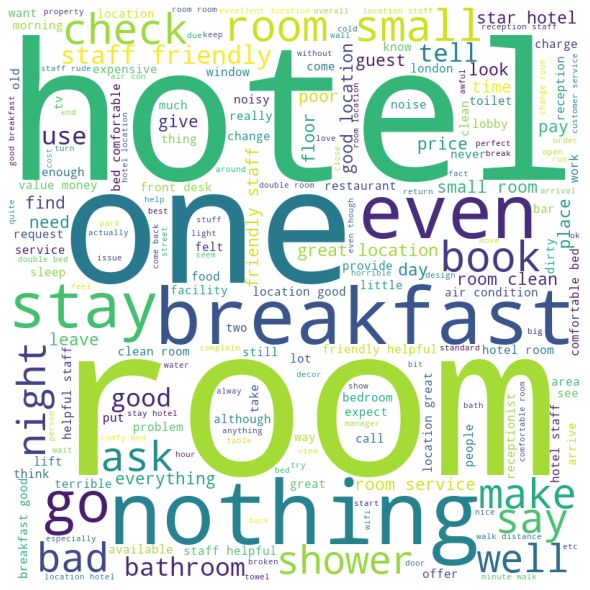

In [89]:
wordcloud_plot(df_sen)

The graph shows the most frequent words taken by review_clean. The most frequent are "hotel", "one", "room".

The next three outputs show reviews sorted by the 3 sentiment scores.

In [90]:
show_most_sentiment(df_sen,"pos")

,review,pos
80396,Lovely clean comfortable warm,1.000
288980,Great location good value comfortable,0.927
465793,Clean secure friendly helpful staff,0.917
363211,Great staff helpful smiley,0.906
342506,Smile More friendly I hope,0.902
221417,Easy location clean friendly,0.898
263068,Nice clean and friendly,0.897
389173,Great location Clean safe comfortable friendl...,0.890
407546,Great place I enjoyed,0.881
515632,Great neat rooms,0.877


Reviews ordered by pos sentiment.

In [91]:
show_most_sentiment(df_sen,"neg")

,review,neg
50365,no complaints no complaints,1.000
177895,No A C,1.000
476092,All No no no,0.868
67391,Abusive sarcastic m staff,0.861
102885,Dirty very dirty,0.859
402358,Nothing Clean Comfortable,0.832
318516,A disaster Nothing,0.804
494849,dirty old bad food noisy,0.802
152744,Noisy unpleasant staff poor room,0.798
271383,Very bad Very bad,0.791


Reviews ordered by neg sentiment.

In [92]:
show_most_sentiment(df_sen,"neu")

,review,neu
426396,The parking was full and we needed half of ho...,1.0
272308,the facilitie the staff atitude the view,1.0
277011,Every thing Only breakfast,1.0
276751,Staff and general hospitality The location,1.0
276704,breakfast every day the same air conditions d...,1.0
399428,nothing The design location staff Everything,1.0
8708,The room was very cold the radiator did not w...,1.0
276416,Long distance from center staff is not hepfull,1.0
8740,The smallest room and bed i have ever stayed ...,1.0
8837,The account of my colleague who reported that...,1.0


Reviews ordered by neu sentiment.

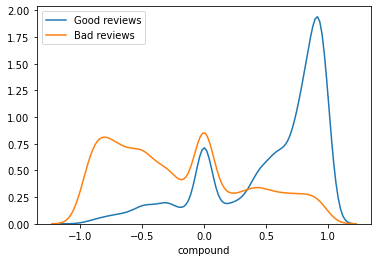

In [93]:
sentiment_distribution_plot(df_sen)

The graph shows the distribution of the reviews sentiments among good reviews and bad reviews.
We can see that the positive reviews for the most part are considered very positive while for the negative reviews they are not considered very negative.

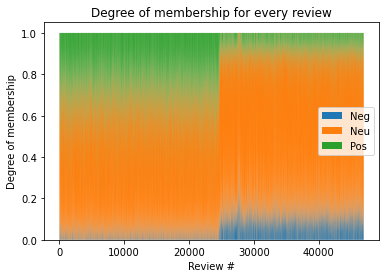

<Figure size 3600x3600 with 0 Axes>

In [94]:
sentiment_stack_plot(df_sen)

This graph shows the breakdown of sentiment scores for each review.
The higher the positivity score, the lower the negativity score and vice versa.

-------------------------
### Correlations

In [95]:
df_corr=prepare_correlation_df(df_sen)

In [96]:
df_structure(df_corr)
df_corr.head(3)

shape:  (46954, 4)
columns:  Index(['days_since_review', 'Reviewer_Nationality', 'pos', 'neg'], dtype='object')


,days_since_review,Reviewer_Nationality,pos,neg
275107,215,Saudi Arabia,0.000,0.158
479647,395,United Kingdom,0.505,0.000
103961,253,Hong Kong,0.210,0.071


Only days_since_review, Reviewer_Nationality, pos and neg columns kept from df_sen.

In [97]:
res_pos=sentiment_correlation(df_corr,"pos","positivity")

Correlation between days since review and positivity degree
Pearson's r:  0.034712123170656146
Spearman's rho:  0.03041842762592568
Kendall's tau:  0.02103027415394725


Low positive correlation between pos and days_since_review in all the methods used.

In [98]:
res_neg=sentiment_correlation(df_corr,"neg","negativity")

Correlation between days since review and negativity degree
Pearson's r:  -0.009203996002277623
Spearman's rho:  -0.01661476643655612
Kendall's tau:  -0.011710829695426729


Low negative correlation between neg and days_since_review in all the methods used.

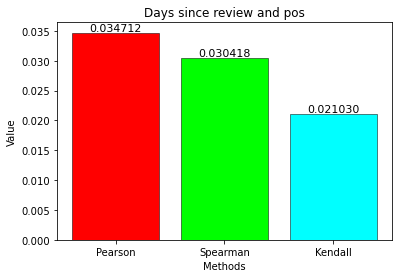

In [99]:
correlation_res_plot(res_pos, "pos")

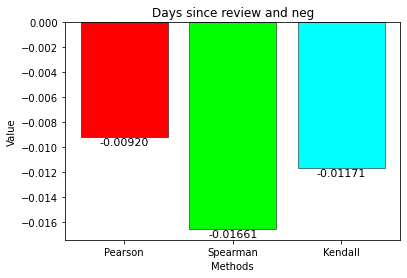

In [100]:
correlation_res_plot(res_neg, "neg")

Between days since review (DSR) and the positive sentiment score there is a positive correlation and logically a negative correlation between DSR and negative sentiment score.
It is therefore understood that the more time passes between the end of the stay and the review, the higher the positive feeling is and less time passes and the higher the negative feeling is.

In [101]:
correlation_dsr_score(df)

Correlation between days since review and reviewer score
Pearson's r days-score:  0.002609574890875373
Spearman's rho days-score:  -0.004816131099356534
Kendall's tau days-score:  -0.003440947438972132


The correlation between days_since_review and reviewer_score is very close to 0 in alle the methods used.

In [102]:
df_naz_pos,df_naz_neg=correlation_days__sent_score_top_nationality(df_corr)

**********
Correlation between days since review and sentiment degree of reviews made by reviewer from  United Kingdom 

Pearson's r days-positivity:  0.05188298839429827
Pearson's r days-negativity:  -0.010222995980851446

Spearman's rho days-positivity:  0.04381795388745906
Spearman's rho days-negativity:  -0.019904601789819124

Kendall's tau days-positivity:  0.03019281105559503
Kendall's tau days-negativity:  -0.014035826786495714

**********
Correlation between days since review and sentiment degree of reviews made by reviewer from  United States of America 

Pearson's r days-positivity:  0.03884917293618872
Pearson's r days-negativity:  0.0029255943628564503

Spearman's rho days-positivity:  0.03919489506815705
Spearman's rho days-negativity:  -0.020124191985041603

Kendall's tau days-positivity:  0.027337433387169943
Kendall's tau days-negativity:  -0.01459476967795661

**********
Correlation between days since review and sentiment degree of reviews made by reviewer from  Austra

In [103]:
df_naz_pos

,Pearson,Spearman,Kendall
Nation,,,
United Kingdom,0.051883,0.043818,0.030193
United States of America,0.038849,0.039195,0.027337
Australia,0.020253,0.027817,0.019018
United Arab Emirates,0.003636,-0.012564,-0.008709
Ireland,0.032904,0.021080,0.014104


In [104]:
df_naz_neg

,Pearson,Spearman,Kendall
Nation,,,
United Kingdom,-0.010223,-0.019905,-0.014036
United States of America,0.002926,-0.020124,-0.014595
Australia,-0.005525,-0.004050,-0.003027
United Arab Emirates,0.013537,-0.013326,-0.009545
Ireland,0.031090,0.020553,0.014448


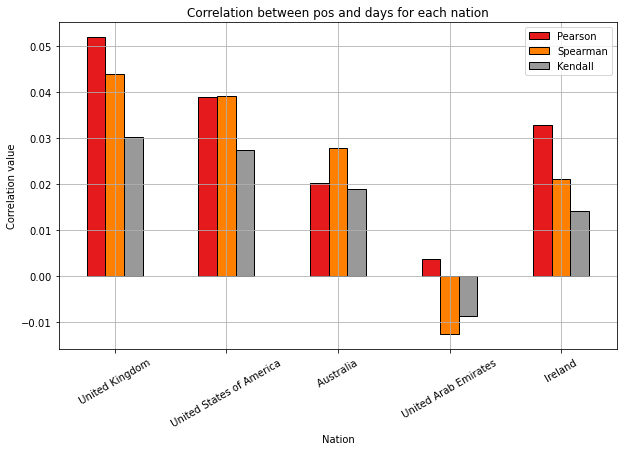

In [105]:
nationality_corr_plot(df_naz_pos,"Correlation between pos and days for each nation","Set1")

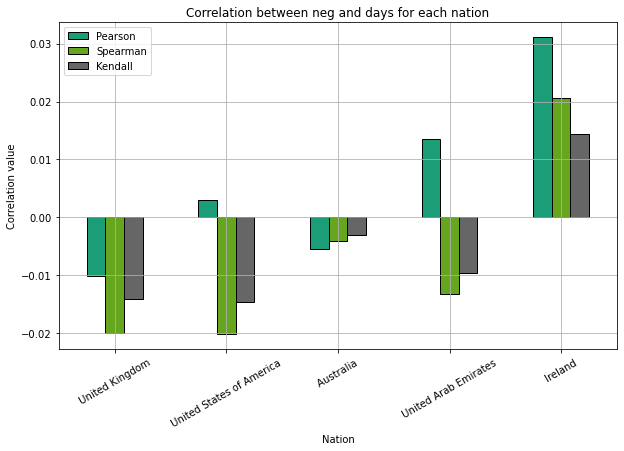

In [106]:
nationality_corr_plot(df_naz_neg,"Correlation between neg and days for each nation","Dark2")

From the two graphs, concerning the correlations on reviews made by different nationalities, it can be deduced that there is mainly a positive correlation for days since review and positive sentiment, with the exception of the Arab Emirates which go negative, with the exception of the correlation calculated with the Pearson method.


There is a mainly negative correlation for days since review and negative sentiment with the exception of Ireland, which has a positive correlation also in this case and the correlations calculated with the Pearson method for the United States and the Arab Emirates.

These two graphs tend to reflect the total correlation values between days since review and the positive and negative sentiments of the reviews.

-----------------
### Frequent subgroups

In [107]:
df_fre=prepare_frequent_df(df)

Cleaning positive reviews
Cleaning positive complete
Cleaning negative reviews
Cleaning negative complete
Cleaning tags
Cleaning tags complete
Splitting values
Splitting done


In [108]:
df_structure(df_fre)
df_fre.head(3)

shape:  (25787, 9)
columns:  Index(['Positive_Review', 'Negative_Review', 'Tags', 'positive_clean',
       'negative_clean', 'tags_clean', 'positive_split', 'negative_split',
       'tags_split'],
      dtype='object')


,Positive_Review,Negative_Review,Tags,positive_clean,negative_clean,tags_clean,positive_split,negative_split,tags_split
488440,Hotel was great clean friendly staff free bre...,Would have appreciated a shop in the hotel th...,"[' Leisure trip ', ' Couple ', ' Double Room '...",hotel great clean friendly staff free breakfas...,would appreciate shop hotel sell drinking wate...,leisure trip couple double room stay night,"[hotel, great, clean, friendly, staff, free, b...","[would, appreciate, shop, hotel, sell, drinkin...","[leisure, trip, couple, double, room, stay, ni..."
274649,No Positive,No tissue paper box was present at the room,"[' Leisure trip ', ' Group ', ' Triple Room ',...",positive,tissue paper box present room,leisure trip group triple room stay night,[positive],"[tissue, paper, box, present, room]","[leisure, trip, group, triple, room, stay, night]"
374688,Nice welcoming and service,Pillows,"[' Business trip ', ' Solo traveler ', ' Twin ...",nice welcoming service,pillow,business trip solo traveler twin room stay nig...,"[nice, welcoming, service]",[pillow],"[business, trip, solo, traveler, twin, room, s..."


Kept only Positive_Review, Negative_review, Tags columns from df.

Added columns:
* positive_clean: colonna Positive_Review in lower case, without punctuation and stop words;
* negative_clean: colonna Negative_Review in lower case, without punctuation and stop words;
* tags_clean: colonna Tags in lower case, without punctuation and stop words;
* positive_split: valori della colonna positive_clean splitted;
* negative_split: valori della colonna negative_clean splitted;
* tags_split: valori della colonna tags_clean splitted;

In [109]:
pos_split=get_column_listed(df_fre,"positive_split")
pos_sup=0.06
freq_pos=frequent_itemsets(pos_split,pos_sup)
out_freq(freq_pos)

     support                     itemsets  length
25  0.149416            (staff, friendly)       2
37  0.149300            (location, staff)       2
39  0.135650                (staff, room)       2
32  0.132858             (staff, helpful)       2
36  0.109241             (location, room)       2
29  0.104277            (location, great)       2
35  0.098460               (staff, hotel)       2
26  0.095940             (location, good)       2
31  0.086749               (great, staff)       2
20  0.080738                (clean, room)       2
33  0.078838            (location, hotel)       2
34  0.078101                (hotel, room)       2
28  0.077714                (staff, good)       2
19  0.074107           (staff, breakfast)       2
27  0.073758                 (good, room)       2
22  0.069686          (comfortable, room)       2
30  0.069686                (great, room)       2
23  0.068058         (location, friendly)       2
18  0.065421            (breakfast, room)       2


Most frequent subgoups with lengh >=2 for positive_split:
* (friendly, staff) with presence of 14.94%
* (location, staff) with presence of 14.93%
* (room, staff) with presence of 13.56%
* (helpful, staff) with presence of 13.28%
* (location, room) with presence of 10.92%

In [110]:
neg_split=get_column_listed(df_fre,"negative_split")
neg_sup=0.02
freq_neg=frequent_itemsets(neg_split,neg_sup)
out_freq(freq_neg)

     support           itemsets  length
76  0.072013      (room, small)       2
70  0.053826      (hotel, room)       2
67  0.033777  (breakfast, room)       2
69  0.031605        (get, room)       2
66  0.031295        (bed, room)       2
77  0.030015      (staff, room)       2
74  0.029201        (room, one)       2
81  0.028037      (would, room)       2
68  0.026758      (could, room)       2
65  0.026641   (bathroom, room)       2
73  0.025943      (night, room)       2
78  0.024431       (room, stay)       2
80  0.022608       (work, room)       2
75  0.022414    (service, room)       2
79  0.022065       (time, room)       2
72  0.020204       (need, room)       2
71  0.020049       (like, room)       2


Most frequent subgoups with lengh >=2 for negative_split:
* (small, room) with presence of 7.2%
* (hotel, room) with presence of 5.38%
* (room, breakfast) with presence of 3.37%
* (get, room) with presence of 3.16%
* (bed, room) with presence of 3.12%

In [111]:
tag_split=get_column_listed(df_fre,"tags_split")
tag_sup=0.6
freq_tag=frequent_itemsets(tag_split,tag_sup)
out_freq(freq_tag)

     support                            itemsets  length
18  0.974134                       (night, stay)       2
20  0.970644                       (trip, night)       2
36  0.945825                 (trip, night, stay)       3
23  0.945825                        (trip, stay)       2
17  0.931555                       (night, room)       2
21  0.913212                        (room, stay)       2
34  0.913212                 (night, room, stay)       3
22  0.904952                        (trip, room)       2
35  0.904952                 (trip, night, room)       3
37  0.886959                  (trip, room, stay)       3
43  0.886959           (trip, night, room, stay)       4
14  0.808082                     (trip, leisure)       2
29  0.807771              (trip, leisure, night)       3
11  0.807771                    (leisure, night)       2
32  0.786482               (trip, leisure, stay)       3
28  0.786482              (leisure, night, stay)       3
41  0.786482        (trip, leis

Most frequent subgoups with lengh >=2 for tags_split:
* (night, stay) with presence of 97.41%
* (night, trip) with presence of 97.06%
* (night, trip, stay) with presence of 94.58%
* (trip, stay) with presence of 94.58%
* (night, room) with presence of 93.15%

--------------------------
### Regression model

In [112]:
df_reg=prepare_regression_df(df)

In [113]:
df_structure(df_reg)
df_reg.head(3)

shape:  (515738, 3)
columns:  Index(['Reviewer_Score', 'Hotel_Country', 'is_bad'], dtype='object')


,Reviewer_Score,Hotel_Country,is_bad
Review_Date,,,
2017-08-03,2.9,NL,1
2017-08-03,7.5,NL,0
2017-07-31,7.1,NL,0


Kept only Reviewer_Score, Hotel_Country, Review_Date (transformed in index) from df.

Added column:
* is_bad: 1 if score < 5, 0 if not.

NL


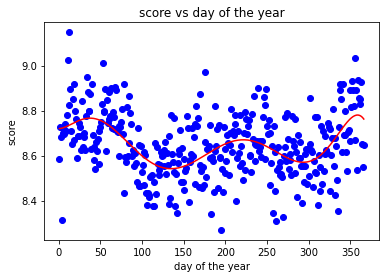

R2 score : 0.25
Mean squared error: 0.02

GB


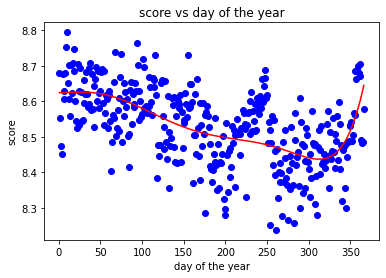

R2 score : 0.35
Mean squared error: 0.01

FR


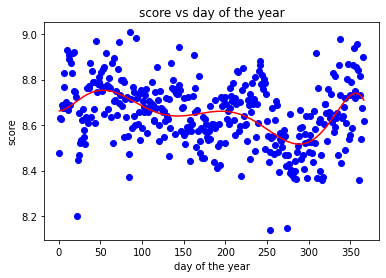

R2 score : 0.22
Mean squared error: 0.02

ES


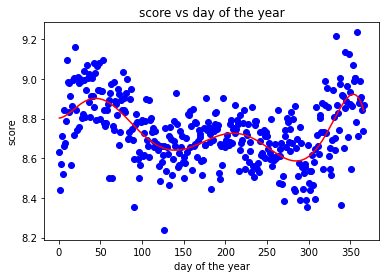

R2 score : 0.37
Mean squared error: 0.02

IT


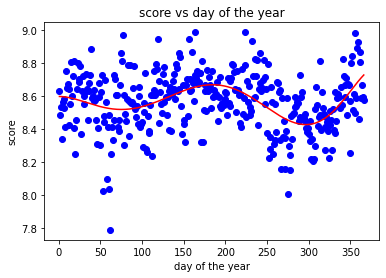

R2 score : 0.17
Mean squared error: 0.03

AT


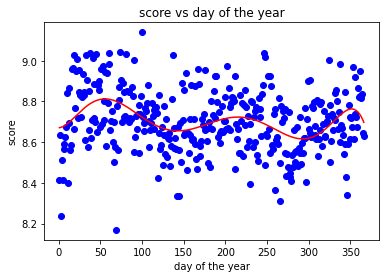

R2 score : 0.12
Mean squared error: 0.02



In [114]:
regression_per_state(df_reg)

There is generally a fluctuating trend that tends to fall towards the center of the year and then rise again for the winter season.

In the graph concerning Italy there is growth also in the middle of the year (summer) as Italy is one of the most favorite summer tourist destinations.

The R2 scores vary from a minimum of 0.12 for Austria to a maximum of 0.37 for Spain.

The mean squared error is for the most part fixed at a value of 0.02.

## Review rating based on text

The comments about the results are after the training and test phases.

### MLP Classifier

In [115]:
df_pred_MLP,newDataTF,d2v_model=prepare_mlp_df(df_sen)

Adding doc2vec columns
Added doc2vec columns
Adding tf-idf columns
Added tf-idf columns


In [116]:
df_structure(df_pred_MLP)
df_pred_MLP.head(3)

shape:  (46954, 4270)
columns:  Index(['review', 'review_clean', 'is_bad', 'nb_chars', 'nb_words', 'neg',
       'neu', 'pos', 'compound', 'doc2vec_vector_0',
       ...
       'word_yoghurt', 'word_yogurt', 'word_young', 'word_youth', 'word_yr',
       'word_yummy', 'word_zero', 'word_zone', 'word_zoo', 'word_zuid'],
      dtype='object', length=4270)


,review,review_clean,is_bad,nb_chars,nb_words,neg,neu,pos,compound,doc2vec_vector_0,...,word_yoghurt,word_yogurt,word_young,word_youth,word_yr,word_yummy,word_zero,word_zone,word_zoo,word_zuid
275107,Nothing Breakfast was excellent metro statio...,nothing breakfast excellent metro station mete...,0,105,20,0.158,0.842,0.000,-0.4585,-0.292658,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
479647,Everything was lovely Would recommend it to e...,everything lovely would recommend everyone wan...,0,88,16,0.000,0.495,0.505,0.8807,-0.218687,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
103961,For subsequent 3 days no wifi service even th...,subsequent day wifi service even telephone una...,0,486,90,0.071,0.719,0.210,0.9296,0.106353,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


kept only review, is_bad, review_clean, colonne di sentiment, nb_chars e nb_word columns from df_sen

New columns:
* doc2vec_vector_X: columns concerning the doc2vector that contain a vector version of the review;
* word_XXX: tf-idf columns that contain the tf-idf values of each word in review_clean.

The results from running the following cells may vary on rerun.

In [117]:
X_train_MLP, X_test_MLP, y_train_MLP, y_test_MLP=feature_selection_tts_mlp(df_pred_MLP)

* Train size: 80%
* Test size: 20%

In [118]:
mlp=mlp_train(X_train_MLP, y_train_MLP)

Iteration 1, loss = 0.53717468
Validation score: 0.791589
Iteration 2, loss = 0.39839096
Validation score: 0.846420
Iteration 3, loss = 0.36623322
Validation score: 0.853340
Iteration 4, loss = 0.34352830
Validation score: 0.803034
Iteration 5, loss = 0.33537895
Validation score: 0.859729
Iteration 6, loss = 0.32976110
Validation score: 0.856268
Iteration 7, loss = 0.32350189
Validation score: 0.852010
Iteration 8, loss = 0.31246822
Validation score: 0.807559
Iteration 9, loss = 0.30877983
Validation score: 0.737024
Iteration 10, loss = 0.31854860
Validation score: 0.858664
Iteration 11, loss = 0.30734171
Validation score: 0.856534
Iteration 12, loss = 0.29146991
Validation score: 0.839500
Iteration 13, loss = 0.28420951
Validation score: 0.851211
Iteration 14, loss = 0.27731005
Validation score: 0.845089
Iteration 15, loss = 0.27472023
Validation score: 0.843758
Iteration 16, loss = 0.27312038
Validation score: 0.748470
Iteration 17, loss = 0.27453996
Validation score: 0.847485
Iterat

In [119]:
predictions_MLP=mlp_test(mlp,X_test_MLP)

In [120]:
false_positive_rate_MLP, true_positive_rate_MLP, thresholds_MLP,roc_auc_MLP=roc_conf_class_rep(y_test_MLP, predictions_MLP)

AUC:  0.8511167518921698
[[4002  924]
 [ 492 3973]]
              precision    recall  f1-score   support

           0       0.89      0.81      0.85      4926
           1       0.81      0.89      0.85      4465

    accuracy                           0.85      9391
   macro avg       0.85      0.85      0.85      9391
weighted avg       0.85      0.85      0.85      9391



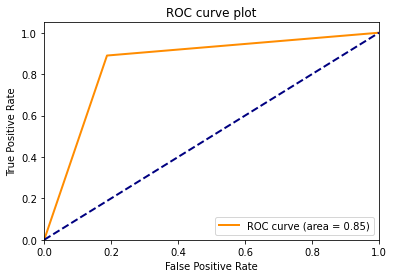

In [121]:
plot_ROC(false_positive_rate_MLP, true_positive_rate_MLP,roc_auc_MLP)

-----------------
### Logistic regression

In [122]:
df_pred_lr=prepare_lr_df(df_sen)

In [123]:
df_structure(df_pred_lr)
df_pred_lr.head(3)

shape:  (46954, 2)
columns:  Index(['review', 'is_bad'], dtype='object')


,review,is_bad
275107,Nothing Breakfast was excellent metro statio...,0
479647,Everything was lovely Would recommend it to e...,0
103961,For subsequent 3 days no wifi service even th...,0


Kept only review e is_bad columns from df_sen.

The results from running the following cells may vary on rerun.

In [124]:
X_train_LR, X_test_LR, y_train_LR, y_test_LR=feature_selection_tts_lr(df_pred_lr)

* Train size: 80%
* Test size: 20%

In [125]:
lrm,cvect=lrm_train(X_train_LR, y_train_LR)

In [126]:
predictions_LRM=lrm_test(lrm,X_test_LR,cvect)

In [127]:
false_positive_rate_LR, true_positive_rate_LR, thresholds_LR,roc_auc_LR=roc_conf_class_rep(y_test_LR, predictions_LRM)

AUC:  0.8469532962423942
[[4239  687]
 [ 744 3721]]
              precision    recall  f1-score   support

           0       0.85      0.86      0.86      4926
           1       0.84      0.83      0.84      4465

    accuracy                           0.85      9391
   macro avg       0.85      0.85      0.85      9391
weighted avg       0.85      0.85      0.85      9391



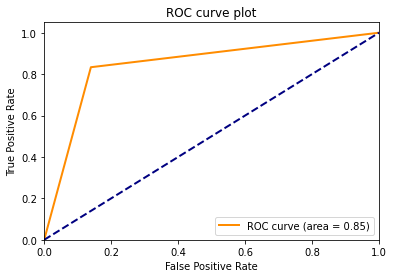

In [128]:
plot_ROC(false_positive_rate_LR, true_positive_rate_LR,roc_auc_LR)

### Test models

In [129]:
rev_1="really awful place"#negative reivew
rev_2="really beautiful place"#positive reivew

In [130]:
MLP_PredictReview(mlp,rev_1,newDataTF,d2v_model)

Good review


array([0], dtype=int64)

In [131]:
MLP_PredictReview(mlp,rev_2,newDataTF,d2v_model)

Good review


array([0], dtype=int64)

In [132]:
LRM_PredictReview(rev_1,cvect)

Bad review


array([1], dtype=int64)

In [133]:
LRM_PredictReview(rev_2,cvect)

Good review


array([0], dtype=int64)

-------------------------
### Comments about the classificators results

#### MLP

In [134]:
Image(url= "https://raw.githubusercontent.com/vvalsecchi/Data_Mining_Project/main/img/mlp_train.JPG")

The MLP classifier iterated 21 times, after which it self-stopped thanks to the early_stopping function, since the validation score did not increase by at least the tol value for the next 15 epochs.

In [135]:
Image(url= "https://raw.githubusercontent.com/vvalsecchi/Data_Mining_Project/main/img/mlp_classification_report.JPG")

The accuracy of predictions on X_test_MLP is 85%.

As can be seen from the confusion matrix there is a greater tendency towards miscalssification for positive reviews (is_bad = 0) which are classified as negative.

Negative reviews (is_bad = 1) that are misclassified are less than half of the misclassified positive reviews.

In the prediction phase, positive reviews are more likely to be misclassified.

In [136]:
Image(url= "https://raw.githubusercontent.com/vvalsecchi/Data_Mining_Project/main/img/mlp_roc.JPG")

In the ROC curve it can be seen that the true positive rate (TPR) value after 0.85 increases much slower than the false positive rate (FPR) which instead increases much faster. Therefore the ideal value of TPR is 0.85, that is the area under the ROC curve (AUC), in such a way as to have a value of FPR as low as possible.

In [137]:
Image(url= "https://raw.githubusercontent.com/vvalsecchi/Data_Mining_Project/main/img/lrc_classification_report.JPG")

The accuracy of predictions on X_test_LR is 85%.

As can be seen from the confusion matrix there is a greater tendency to miscalssification for negative reviews (is_bad = 1) which are classified as positive.

The positive reviews (is_bad = 0) that are misclassified are almost the same number as the negative miscalsified ones.

In the prediction phase it is easier for negative reviews to be classified badly but compared to the MLP the differences are narrower as the misclassification values for the LRC are quite similar between positive and negative.

In [138]:
Image(url= "https://raw.githubusercontent.com/vvalsecchi/Data_Mining_Project/main/img/lrc_roc.JPG")

In the ROC curve it can be seen that the true positive rate (TPR) value after 0.85 increases much slower than the false positive rate (FPR) which instead increases much faster. Therefore the ideal value of TPR is 0.85, that is the area under the ROC curve (AUC), in such a way as to have a value of FPR as low as possible.

In [139]:
Image(url= "https://raw.githubusercontent.com/vvalsecchi/Data_Mining_Project/main/img/risultati_prediction.JPG")

By providing two reviews rev_1 and rev_2, respectively negative review and positive review:

* the MLP classifier provided 2 positive predictions so it has misclassified the negative review, although a positive review was more likely to be missclassified.
* the LRM provided 2 correct predictions so no misclassification.

We can say that the LRM performs better than the MLP classifier, despite the fact that the MLP classifier made use of the sentiment analysis values, doc2vec and tf-idf while LRM only made use of the count vectorizer carried out on the reviews.